In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6
# Download MT-YOLOv6 repository and install requirements
# !git clone https://github.com/meituan/YOLOv6
%cd YOLOv6
!pip install -r requirements.txt

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6
/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 82.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 101.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 93.7 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
numba 0.56.4 requires numpy<1.24,>=1.18, but you have numpy 1.24.3 which is incompatible.
tensorflow 2.12.0 requires numpy<1.24,>=1.22, but you have numpy 1.

# Dataset




In [2]:
!pip install roboflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 9.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.3 MB/s eta 0:00:00
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=a5f9bee87c1a991bad6f265d8566f75138c048e1802706886c1343ba523b4d5d
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pyparsing-3.0.9:
      Successfully uninstalled pyparsing-3.0.9
  Attempting uninstall: idna
    Found existing installation: idna 3.4
    Uninstalling idna-3.4:
    

In [3]:
%cd /content/drive/MyDrive/Dataset-pbl5
from roboflow import Roboflow
rf = Roboflow(api_key="JytgQHQAi66ECoAWaYrR")
project = rf.workspace("pbl-uj4wt").project("pbl5-6p2ne")
dataset = project.version(1).download("yolov5")

/content/drive/MyDrive/Dataset-pbl5
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to PBL5-1 in yolov5pytorch:: 100%|██████████| 17966/17966 [02:17<00:00, 130.48it/s]


# Custom Training Details

There are a number of ways to fine tune training of YOLOv6, like custom configuration files for fine tuning, multi GPU support, and passing custom training arguments.


### Multi GPU Support

YOLOv6 supports single and multi GPU training.

Single GPU:
```
python tools/train.py --batch 256 --conf configs/yolov6s_finetune.py --data data/data.yaml --device 0
```

Multi GPU:
```
python -m torch.distributed.launch --nproc_per_node 4 tools/train.py --batch 256 --conf configs/yolov6s_finetune.py --data data/data.yaml --device 0,1,2,3
```

### Custom Configuration

YOLOv6 also supports creating a custom configuration file for training YOLOv6-n, YOLOv6-tiny, and YOLOv6s. (YOLOv6 m/l/x are coming soon.) You can also start training with a configuration that uses finetuning (e.g. `yolov6s_finetune.py` or starting from scratch (`yolov6s.py`). Finetuning will train faster though may not be as effective on unique datasets.

### Default Arguments
- --data-path, default='./data/coco.yaml', type=str, help='path of dataset')
- --conf-file, default='./configs/yolov6s.py', type=str, help='experiments description file')
- --img-size, type=int, default=640, help='train, val image size (pixels)')
- --batch-size, default=32, type=int, help='total batch size for all GPUs')
- --epochs, default=400, type=int, help='number of total epochs to run')
- --workers, default=8, type=int, help='number of data loading workers (default: 8)')
- --device, default='0', type=str, help='cuda device, i.e. 0 or 0,1,2,3 or cpu')
- --eval-interval, type=int, default=20, help='evaluate at every interval epochs')
- --eval-final-only, action='store_true', help='only evaluate at the final epoch')
- --heavy-eval-range, default=50,help='evaluating every epoch for last such epochs (can be jointly used with --eval-interval)')
- --check-images, action='store_true', help='check images when initializing datasets')
- --check-labels, action='store_true', help='check label files when initializing datasets')
- --output-dir, default='./runs/train', type=str, help='path to save outputs')
- --name, default='exp', type=str, help='experiment name, saved to output_dir/name')
- --dist_url, type=str, default="default url: tcp://127.0.0.1:8888")
- --gpu_count, type=int, default=0)
- --local_rank, type=int, default=-1, help='DDP parameter')
- --resume, type=str, default=None, help='resume the corresponding ckpt')


# yolov6s


## Train

In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6/YOLOv6

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6


In [ ]:
!python tools/train.py --batch 16 --epoch 50 --conf configs/yolov6s_finetune.py \
--data /content/PBL5-1/data.yaml --device 0 \
--fuse_ab --name yolov6s_tfs_newDS

2023-05-18 18:02:10.318500: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-18 18:02:11.177356: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Using 1 GPU for training... 
training args are: Namespace(data_path='/content/PBL5-1/data.yaml', conf_file='configs/yolov6s_finetune.py', img_size=640, rect=False, batch_size=16, epochs=50, workers=8, device='0', eval_interval=20, eval_final_only=False, heavy_eval_range=50, check_images=False, check_labels=False, output_dir='./runs/train', name='yolov6s_tfs_newDS', dist_url='env://', gpu_count=0, local_rank=-1, resume=False, write_trainbatch_tb=False, stop_aug_last_n_epoch=15, save_ckpt_on_last_n_epoch=-1, distill=False, distill_feat=False, quant=False, cali

## Evaluation

We can evaluate the performance of our custom training using the provided evalution script.

Note we can adjust the below custom arguments.

- --data, type=str, default='./data/coco.yaml', help='dataset.yaml path')
- -weights, type=str, default='./weights/yolov6s.pt', help='model.pt path(s)')
- --batch-size, type=int, default=32, help='batch size')
- --img-size, type=int, default=640, help='inference size (pixels)')
- --conf-thres, type=float, default=0.001, help='confidence threshold')
- --iou-thres, type=float, default=0.65, help='NMS IoU threshold')
- --task, default='val', help='val, or speed')
- --device, default='0', help='cuda device, i.e. 0 or 0,1,2,3 or cpu')
- --half, default=False, action='store_true', help='whether to use fp16 infer')
- --save_dir, type=str, default='runs/val/', help='evaluation save dir')
- -name, type=str, default='exp', help='save evaluation results to save_dir/name')


In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6/YOLOv6

# Run evaluation
!python tools/eval.py --batch-size 1 --data /content/PBL5-1/data.yaml --conf-thres 0.3 --iou-thres 0.5 \
--weights /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6s_tfs_newDS/weights/best_ckpt.pt \
--device 0 --task test --name eval_test --do_pr_metric True

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6
Namespace(data='/content/PBL5-1/data.yaml', weights='/content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6s_tfs_newDS/weights/best_ckpt.pt', batch_size=1, img_size=640, conf_thres=0.3, iou_thres=0.5, task='test', device='0', half=False, save_dir='runs/val/', name='eval_test', shrink_size=0, infer_on_rect=True, reproduce_640_eval=False, eval_config_file='./configs/experiment/eval_640_repro.py', do_coco_metric=True, do_pr_metric=True, plot_curve=True, plot_confusion_matrix=False, verbose=False, config_file='', specific_shape=False, height=None, width=None)
The best conf_thresh when evaluate the model is less than 0.03, while you set it to: 0.3
The best iou_thresh when evaluate the model is 0.65, while you set it to: 0.5
Loading checkpoint from /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6s_tfs_newDS/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
Model Su

## Inference

We can run inference on images of our custom trained model using the provided inference utility.

There are a number of arguments we can adjust:

- --weights, type=str, default='weights/yolov6s.pt', help='model path(s) for inference.')
- --source, type=str, default='data/images', help='the source path, e.g. image-file/dir.')
- --yaml, type=str, default='data/coco.yaml', help='data yaml file.')
- --img-size, type=int, default=640, help='the image-size(h,w) in inference size.')
- --conf-thres, type=float, default=0.25, help='confidence threshold for inference.')
- --iou-thres, type=float, default=0.45, help='NMS IoU threshold for inference.')
- --max-det, type=int, default=1000, help='maximal inferences per image.')
- --device, default='0', help='device to run our model i.e. 0 or 0,1,2,3 or cpu.')
- --save-txt, action='store_true', help='save results to *.txt.')
- --save-img, action='store_false', help='save visuallized inference results.')
- --classes, nargs='+', type=int, help='filter by classes, e.g. --classes 0, or --classes 0 2 3.')
- --agnostic-nms, action='store_true', help='class-agnostic NMS.')
- --project, default='runs/inference', help='save inference results to project/name.')
- -name, default='exp', help='save inference results to project/name.')
- --hide-labels, default=False, action='store_true', help='hide labels.')
- --hide-conf, default=False, action='store_true', help='hide confidences.')
- --half, action='store_true', help='whether to use FP16 half-precision inference.')

We need to pass our custom `.yaml` file so that our label names are correct. We will also pass our `/test` directory to run inference on all images in our test split. In addition, similar to training, we will pass 416x416 images for inference as an example.


In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6/YOLOv6
# infer on all images in our /test directory
!python tools/infer.py --yaml {dataset.location}/data.yaml \
--weights /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6s_tfs_newDS/weights/best_ckpt.pt \
--source {dataset.location}/images/test/ --device 0 --name v6s_infer

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6
Namespace(weights='/content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6s_tfs_newDS/weights/best_ckpt.pt', source='/content/PBL5-1/images/test/', webcam=False, webcam_addr='0', yaml='/content/PBL5-1/data.yaml', img_size=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device='0', save_txt=False, not_save_img=False, save_dir=None, view_img=False, classes=None, agnostic_nms=False, project='runs/inference', name='v6s_infer', hide_labels=False, hide_conf=False, half=False)
Loading checkpoint from /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6s_tfs_newDS/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
100% 642/642 [00:28<00:00, 22.38it/s]
Results saved to runs/inference/v6s_infer


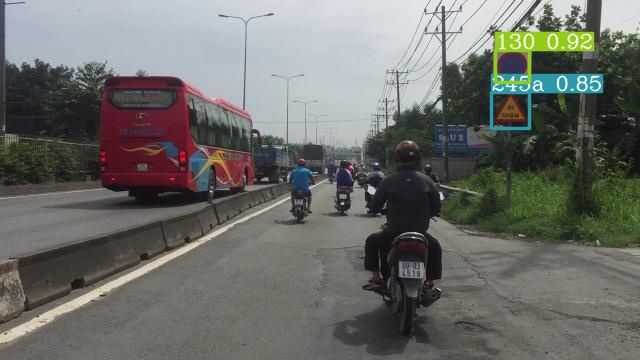

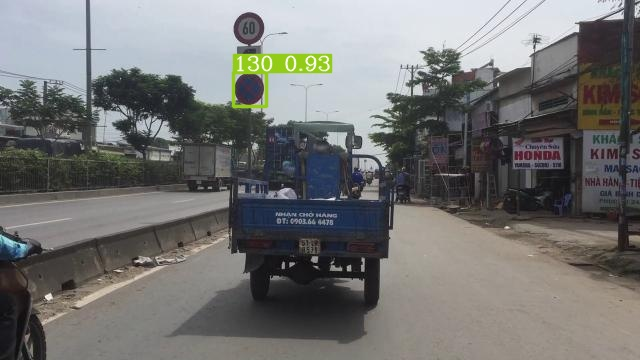

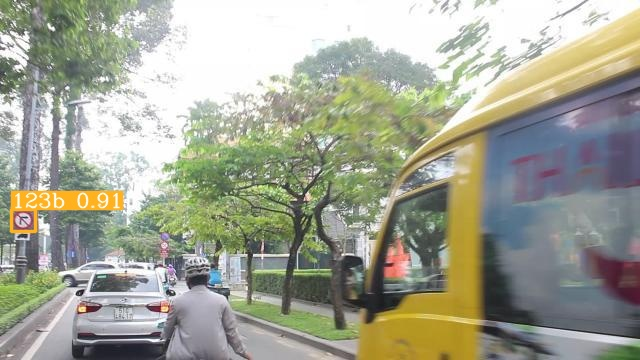

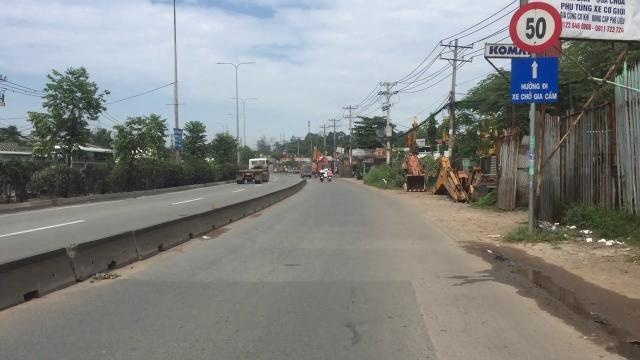

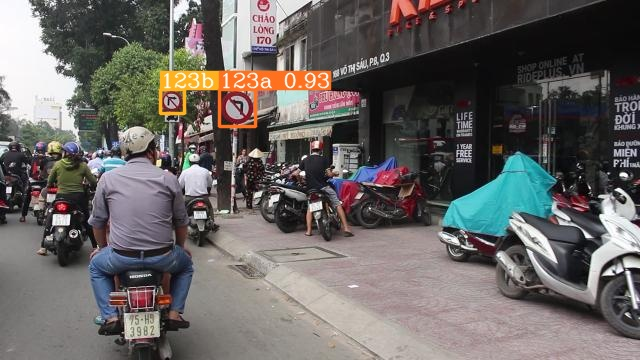

...

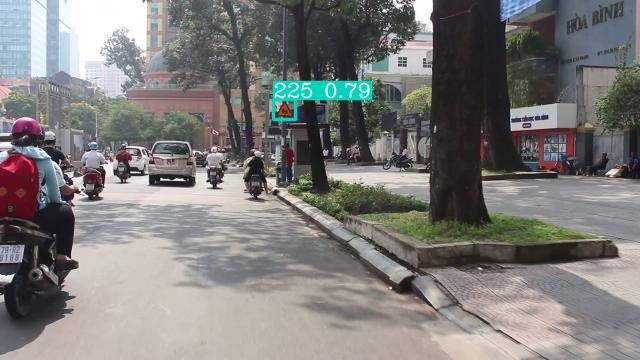

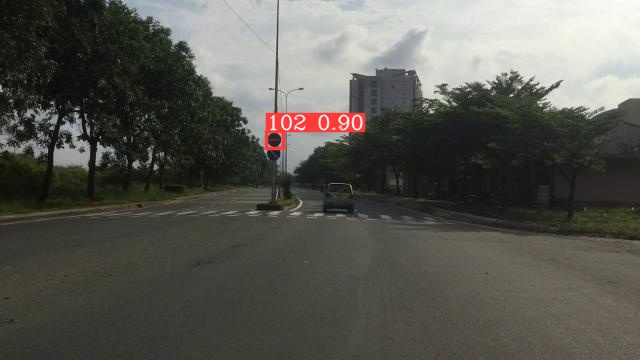

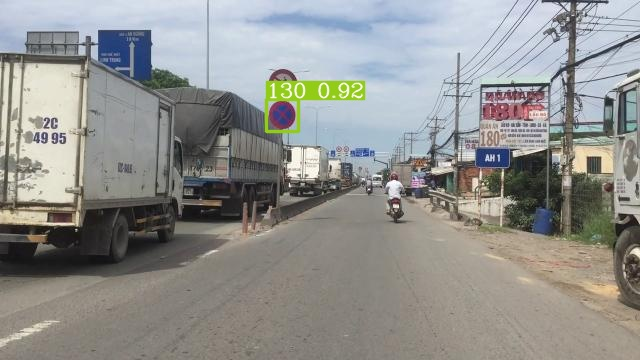

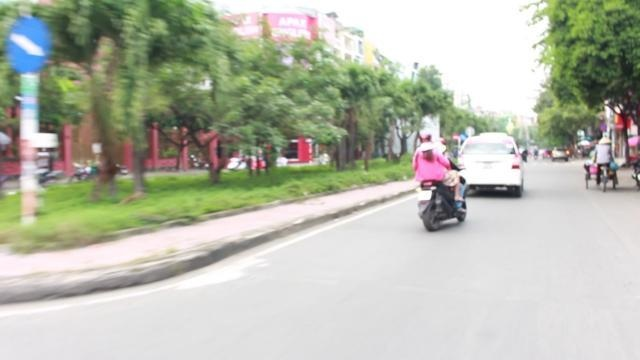

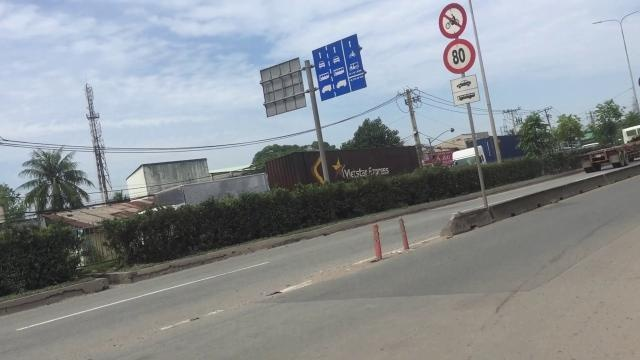

In [ ]:
# display test inference result images
import glob
from IPython.display import Image, display

i = 0
limit = 20 # max images to print
for imageName in glob.glob('./runs/inference/v6s_infer/*.jpg'): #assuming JPG
    if i < limit:
      display(Image(filename=imageName))
      print("\n\n")
    i = i + 1

# Yolov6n

## Train

In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6/YOLOv6

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6


In [ ]:
!python tools/train.py --batch 16 --epoch 50 --conf configs/yolov6n_finetune.py \
--data /content/PBL5-1/data.yaml --device 0 \
--fuse_ab --name yolov6n --write_trainbatch_tb

2023-06-02 05:08:37.937465: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-02 05:08:38.841472: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Using 1 GPU for training... 
training args are: Namespace(data_path='/content/PBL5-1/data.yaml', conf_file='configs/yolov6n_finetune.py', img_size=640, rect=False, batch_size=16, epochs=50, workers=8, device='0', eval_interval=20, eval_final_only=False, heavy_eval_range=50, check_images=False, check_labels=False, output_dir='./runs/train', name='yolov6n', dist_url='env://', gpu_count=0, local_rank=-1, resume=False, write_trainbatch_tb=True, stop_aug_last_n_epoch=15, save_ckpt_on_last_n_epoch=-1, distill=False, distill_feat=False, quant=False, calib=False, te

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Evaluation

We can evaluate the performance of our custom training using the provided evalution script.

Note we can adjust the below custom arguments.

- --data, type=str, default='./data/coco.yaml', help='dataset.yaml path')
- -weights, type=str, default='./weights/yolov6s.pt', help='model.pt path(s)')
- --batch-size, type=int, default=32, help='batch size')
- --img-size, type=int, default=640, help='inference size (pixels)')
- --conf-thres, type=float, default=0.001, help='confidence threshold')
- --iou-thres, type=float, default=0.65, help='NMS IoU threshold')
- --task, default='val', help='val, or speed')
- --device, default='0', help='cuda device, i.e. 0 or 0,1,2,3 or cpu')
- --half, default=False, action='store_true', help='whether to use fp16 infer')
- --save_dir, type=str, default='runs/val/', help='evaluation save dir')
- -name, type=str, default='exp', help='save evaluation results to save_dir/name')


In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6/YOLOv6
# Run evaluation
!python tools/eval.py --batch-size 1 --data /content/PBL5-1/data.yaml --conf-thres 0.3 --iou-thres 0.5 \
--weights /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6n1/weights/best_ckpt.pt \
--device 0 --task test --name v6n_test --do_pr_metric True

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6
Namespace(data='/content/PBL5-1/data.yaml', weights='/content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6n1/weights/best_ckpt.pt', batch_size=1, img_size=640, conf_thres=0.3, iou_thres=0.5, task='test', device='0', half=False, save_dir='runs/val/', name='v6n_test', shrink_size=0, infer_on_rect=True, reproduce_640_eval=False, eval_config_file='./configs/experiment/eval_640_repro.py', do_coco_metric=True, do_pr_metric=True, plot_curve=True, plot_confusion_matrix=False, verbose=False, config_file='', specific_shape=False, height=None, width=None)
The best conf_thresh when evaluate the model is less than 0.03, while you set it to: 0.3
The best iou_thresh when evaluate the model is 0.65, while you set it to: 0.5
Loading checkpoint from /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6n1/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
Model Summary: Params: 4.63

## Inference

We can run inference on images of our custom trained model using the provided inference utility.

There are a number of arguments we can adjust:

- --weights, type=str, default='weights/yolov6s.pt', help='model path(s) for inference.')
- --source, type=str, default='data/images', help='the source path, e.g. image-file/dir.')
- --yaml, type=str, default='data/coco.yaml', help='data yaml file.')
- --img-size, type=int, default=640, help='the image-size(h,w) in inference size.')
- --conf-thres, type=float, default=0.25, help='confidence threshold for inference.')
- --iou-thres, type=float, default=0.45, help='NMS IoU threshold for inference.')
- --max-det, type=int, default=1000, help='maximal inferences per image.')
- --device, default='0', help='device to run our model i.e. 0 or 0,1,2,3 or cpu.')
- --save-txt, action='store_true', help='save results to *.txt.')
- --save-img, action='store_false', help='save visuallized inference results.')
- --classes, nargs='+', type=int, help='filter by classes, e.g. --classes 0, or --classes 0 2 3.')
- --agnostic-nms, action='store_true', help='class-agnostic NMS.')
- --project, default='runs/inference', help='save inference results to project/name.')
- -name, default='exp', help='save inference results to project/name.')
- --hide-labels, default=False, action='store_true', help='hide labels.')
- --hide-conf, default=False, action='store_true', help='hide confidences.')
- --half, action='store_true', help='whether to use FP16 half-precision inference.')

We need to pass our custom `.yaml` file so that our label names are correct. We will also pass our `/test` directory to run inference on all images in our test split. In addition, similar to training, we will pass 416x416 images for inference as an example.


In [ ]:
%cd /content/drive/MyDrive/PBL5_yolov6/YOLOv6
# infer on all images in our /test directory
!python tools/infer.py --yaml {dataset.location}/data.yaml \
--weights /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6n1/weights/best_ckpt.pt \
--source {dataset.location}/images/test/ --device 0 --name infer_v6n

/content/drive/.shortcut-targets-by-id/1TAuKYRs_WDd5oJCvq7Qx_5b4PJDp9FwF/PBL5_yolov6/YOLOv6
Namespace(weights='/content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6n1/weights/best_ckpt.pt', source='/content/PBL5-1/images/test/', webcam=False, webcam_addr='0', yaml='/content/PBL5-1/data.yaml', img_size=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device='0', save_txt=False, not_save_img=False, save_dir=None, view_img=False, classes=None, agnostic_nms=False, project='runs/inference', name='infer_v6n', hide_labels=False, hide_conf=False, half=False)
Loading checkpoint from /content/drive/MyDrive/PBL5_yolov6/YOLOv6/runs/train/yolov6n1/weights/best_ckpt.pt

Fusing model...
Switch model to deploy modality.
100% 642/642 [00:22<00:00, 28.65it/s]
Results saved to runs/inference/infer_v6n


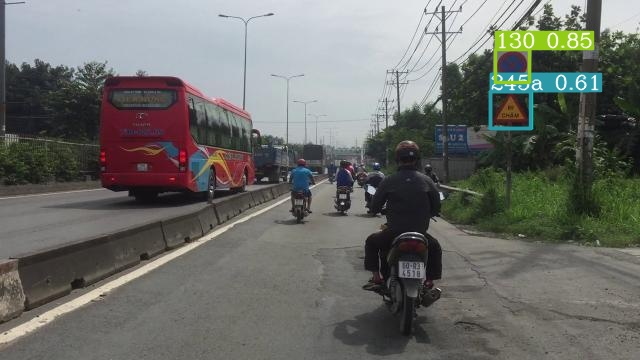

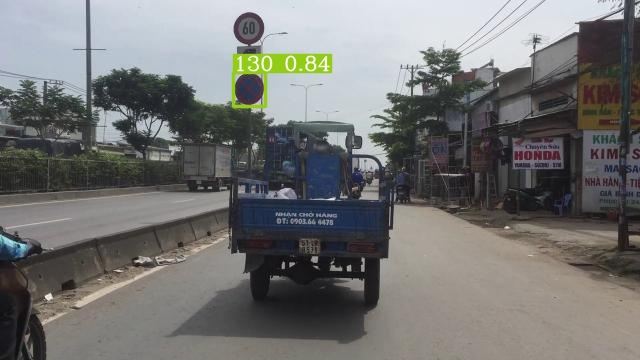

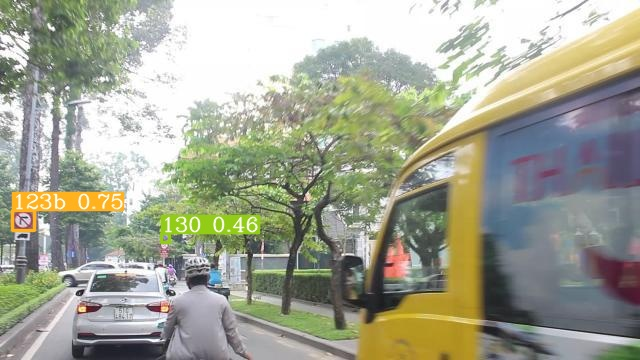

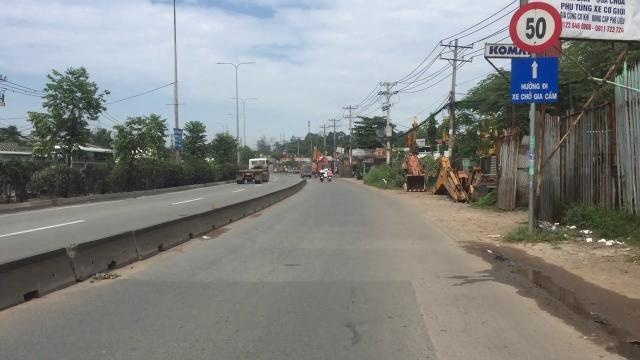

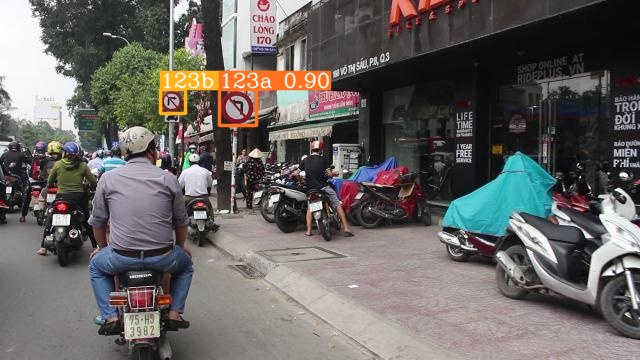

...

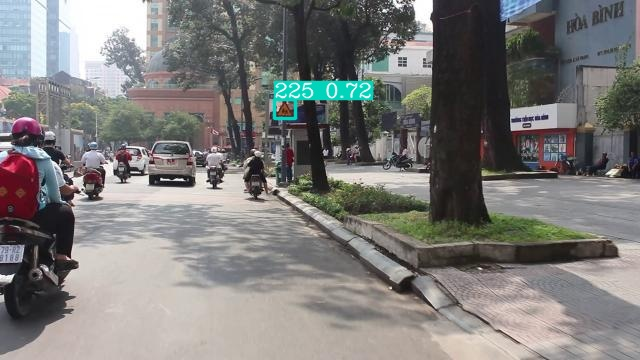

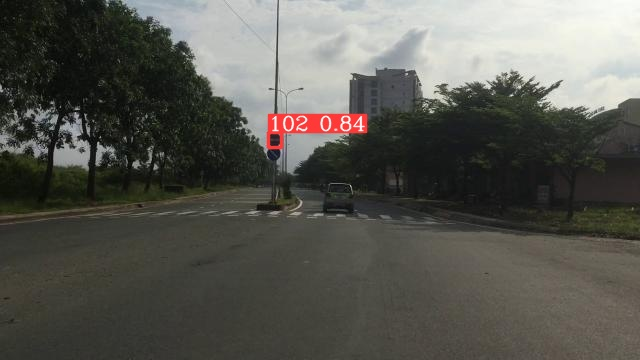

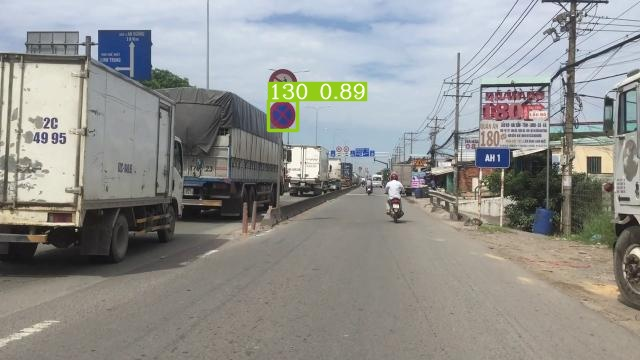

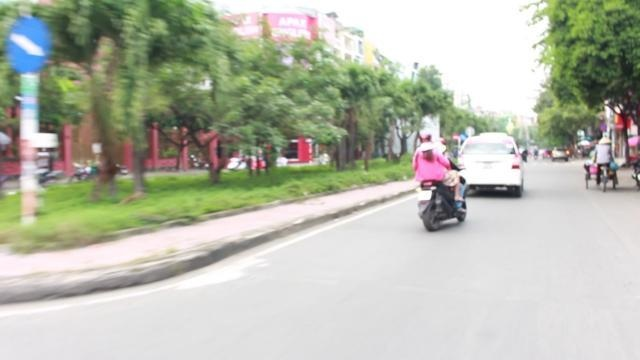

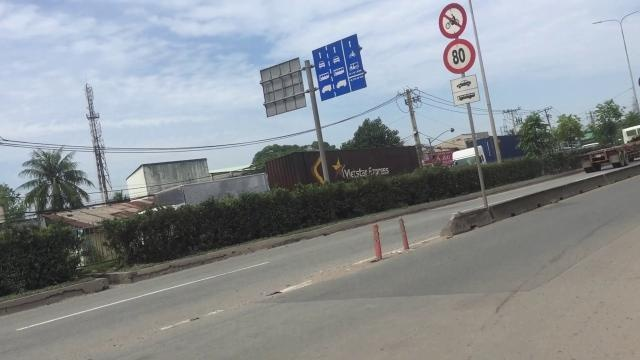

In [ ]:
# display test inference result images
import glob
from IPython.display import Image, display

i = 0
limit = 20 # max images to print
for imageName in glob.glob('./runs/inference/infer_v6n/*.jpg'): #assuming JPG
    if i < limit:
      display(Image(filename=imageName))
      print("\n\n")
    i = i + 1